In [82]:
import torch
import pickle
from pathlib import Path
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt

In [272]:
DIR = Path("genre_activations")
IM_DIR = Path("genre_activations_imgs")
genres = ["blues", "classical", "country", "disco", "hiphop", "jazz", "metal", "pop", "reggae", "rock"]

In [280]:
IDX = [0, 2, 4]

In [295]:
def show(genre, nums):
    
    f1 = [DIR/f"{genre}.0000{n}-style_activations.pkl" for n in nums if n < 10]
    f2 = [DIR/f"{genre}.000{n}-style_activations.pkl" for n in nums if n >= 10]
    files = [open(f, 'rb') for f in f1 + f2]
    
    activations = [pickle.load(_) for _ in files]

    fig, axs = plt.subplots(1, len(IDX), figsize=(10, 10))
    axs[0].set_ylabel(genre)

    for i, idx in enumerate(IDX):
        a, b = [], []
        for acts in activations:
            a_ = acts[idx].squeeze().detach().numpy()
            b_ = acts[idx+1].squeeze().detach().numpy()
            a_ = np.mean(np.transpose(a_, (1,2,0)), axis=2)
            b_ = np.mean(np.transpose(b_, (1,2,0)), axis=2)
            a.append(a_)
            b.append(b_)
        a = [np.resize(_, (400, 400)) for _ in a]
        b = [np.resize(_, (400, 400)) for _ in b]
        arr = (np.mean(a, axis=0) + np.mean(b, axis=0)) / 2
        axs[i].imshow(arr, interpolation='nearest')
    return fig

In [296]:
NUMS = list(range(100))

<ipython-input-295-d64739be5c44>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, len(IDX), figsize=(10, 10))


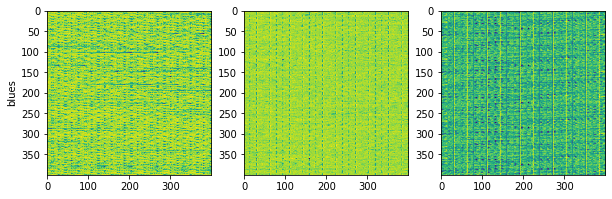

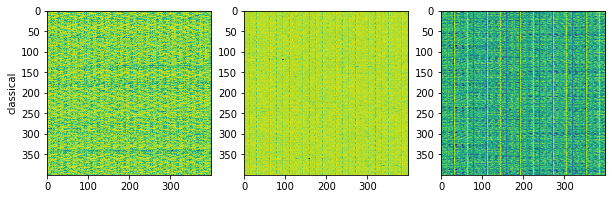

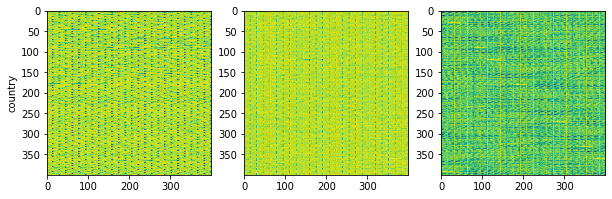

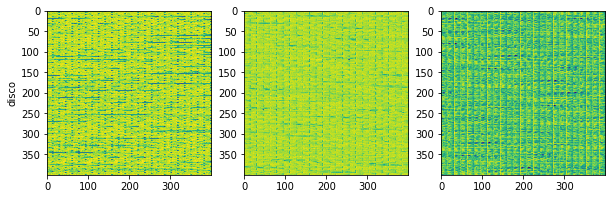

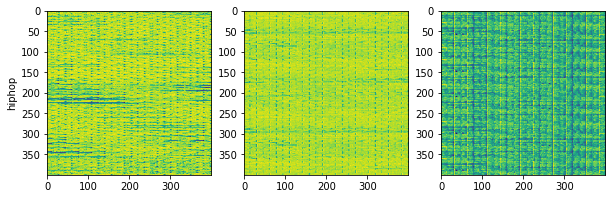

...

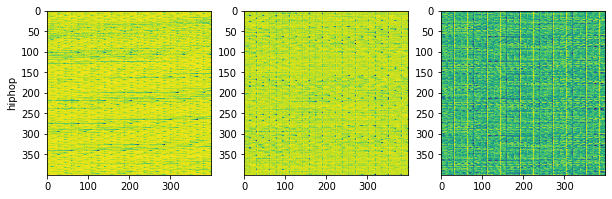

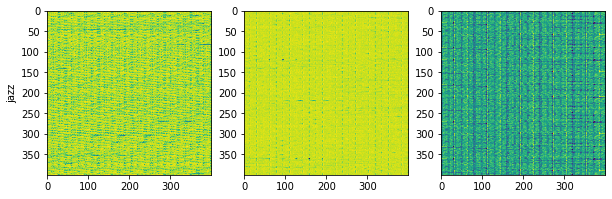

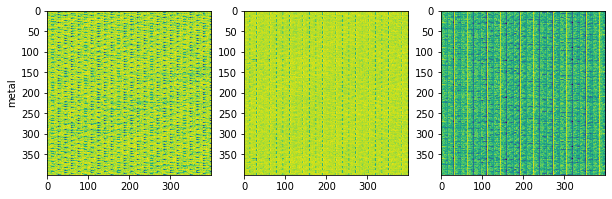

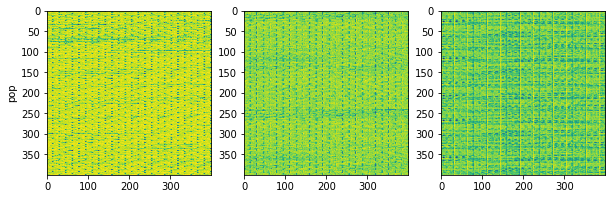

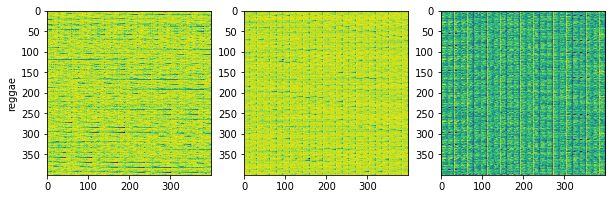

In [ ]:
for i in range(10):
    for g in genres:
        fig = show(g, [i])
        plt.savefig(IM_DIR/f"{g}_0{i}", bbox_inches='tight')

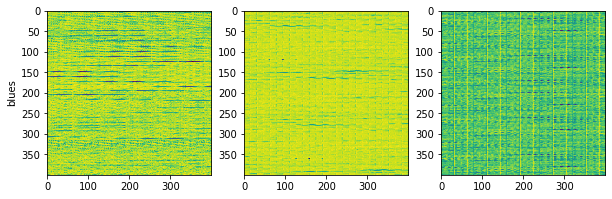

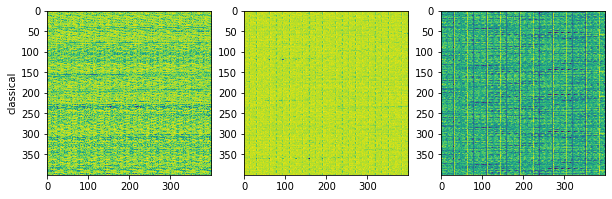

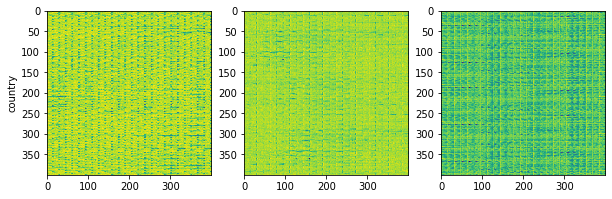

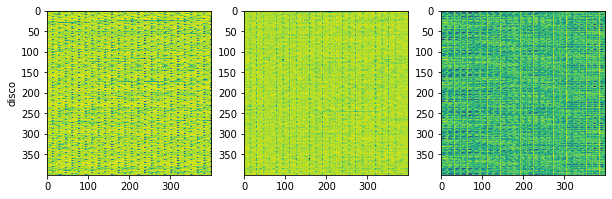

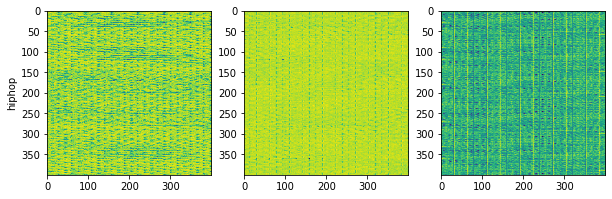

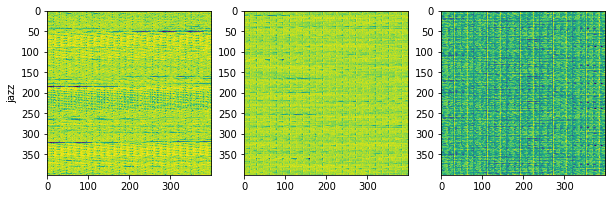

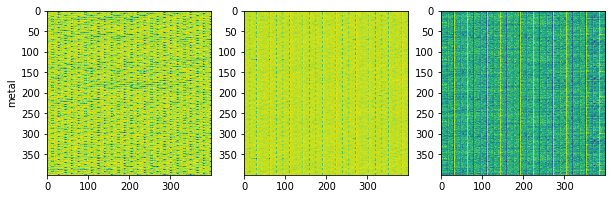

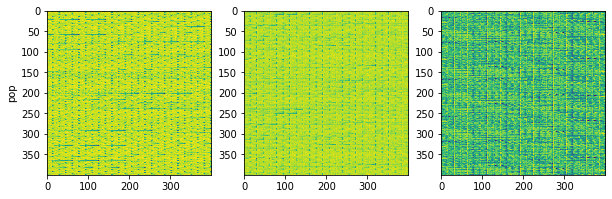

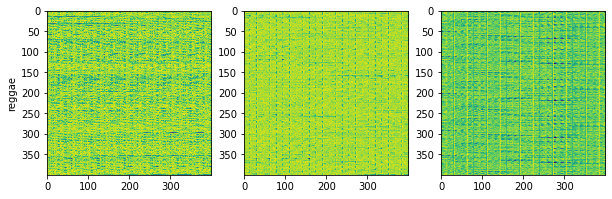

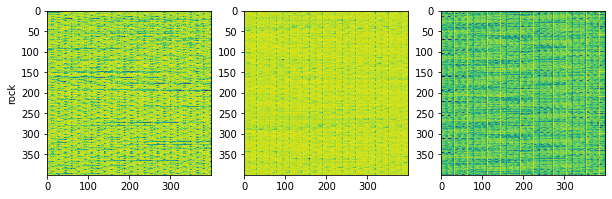

In [285]:
for i in range(10, 100):
    for g in genres:
        fig = show(g, [i])
        plt.savefig(IM_DIR/f"{g}_{i}", bbox_inches='tight')

In [294]:
# all
for g in genres:
    fig = show(g, NUMS)
    plt.savefig(IM_DIR/f"{g}_all", bbox_inches='tight')

FileNotFoundError: [Errno 2] No such file or directory: 'genre_activations/blues.00001-style_activations.pkl'